# Projekt 1: Autoencoder do kolorowania obrazów czarno-białych
## Autorzy: Agnieszka Klimek 145302, Anna Prałat 145395 (grupa L9)
#### Wymagania:
* stworzenie sieci neuronowej typu autoencoder,
* dane wejściowe to obrazy czarno-białe (1 kanał),
* dane wyjściowe to obrazy kolorowe (3 kanały),
* badanie różnych rozmiarów sieci neuronowej,
* badanie wpływu poszczególnych elementów regularyzacji na wynik:
    * wpływ parametru momentum oraz rozmiaru batcha przy wykorzystaniu batch normalization,
    * wpływ dropout rate,
    * wpływ weight decay.

In [10]:
from skimage import color, io
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.datasets import cifar100
from tensorflow.keras.layers import BatchNormalization, Conv2D, Dropout, Conv2DTranspose
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.optimizers import Adam

import matplotlib.pyplot as plt
import tensorflow_addons as tfa
import tensorflow as tf

In [18]:
tf.__version__

'2.4.1'

In [11]:
# detect and init the TPU
tpu = tf.distribute.cluster_resolver.TPUClusterResolver.connect()

# instantiate a distribution strategy
tpu_strategy = tf.distribute.experimental.TPUStrategy(tpu)

2023-01-18 14:19:24.372905: I tensorflow/core/distributed_runtime/rpc/grpc_channel.cc:301] Initialize GrpcChannelCache for job worker -> {0 -> 10.0.0.2:8470}
2023-01-18 14:19:24.372985: I tensorflow/core/distributed_runtime/rpc/grpc_channel.cc:301] Initialize GrpcChannelCache for job localhost -> {0 -> localhost:30020}
2023-01-18 14:19:24.389586: I tensorflow/core/distributed_runtime/rpc/grpc_channel.cc:301] Initialize GrpcChannelCache for job worker -> {0 -> 10.0.0.2:8470}
2023-01-18 14:19:24.389644: I tensorflow/core/distributed_runtime/rpc/grpc_channel.cc:301] Initialize GrpcChannelCache for job localhost -> {0 -> localhost:30020}
2023-01-18 14:19:24.394026: I tensorflow/core/distributed_runtime/rpc/grpc_server_lib.cc:411] Started server with target: grpc://localhost:30020


## 1. Przygotowanie metody wykonującej zadanie kolorowania obrazów czarno-białych

### Pobranie datasetu oraz preprocessing

Do eksperymentów wykorzytano jeden z dostępnych zbiorów biblioteki `TensorFlow` - `cifar100`. Zbiór treningowy zawiera 50 000 elementów, a testowy 10 000.

In [12]:
(y_train, _), (y_test, _) = cifar100.load_data()

y_train = y_train.astype('float32') / 255.
y_test = y_test.astype('float32') / 255.

print(y_train.shape)
print(y_test.shape)

x_train = color.rgb2gray(y_train)
x_test = color.rgb2gray(y_test)

image_size = y_train[0].shape[0]
x_train = x_train.reshape((len(x_train), image_size, image_size, 1))
x_test = x_test.reshape((len(x_test), image_size, image_size, 1))

print(x_train.shape)
print(x_test.shape)

(50000, 32, 32, 3)
(10000, 32, 32, 3)
(50000, 32, 32, 1)
(10000, 32, 32, 1)


### Prezentacja przykładowych obrazów z datasetu

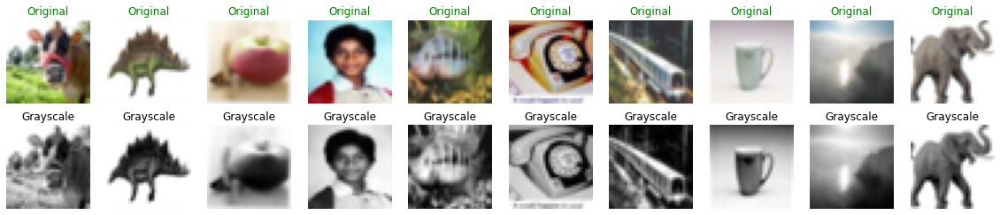

In [13]:
def plot_dataset_images(n = 10):
    plt.figure(figsize = (20, 4))
    for i in range(n):
        plt.subplot(2, n, i + 1)
        plt.title('Original', color = 'green')
        plt.axis('off')
        plt.imshow(y_train[i])

        plt.subplot(2, n, i + 1 + n)
        plt.title('Grayscale', color = 'black')
        plt.axis('off')
        plt.imshow(x_train[i], cmap = 'gray')

plot_dataset_images()

### Stworzenie sieci neuronowej typu autoencoder

#### Warstwa Enkodera
W podstawowej wersji enkodera, zastosowane zostały tylko warstwy konwolucyjne `Conv2D` o rozmiarze okna równym 3. Filtry w kolejnych warstwach miały rozmiary: 32, 64, 128, 256. Jako funkcję aktywacji zastosowano `relu`. Opcjonalnie, po każdej warstwie konwolucyjnej możliwe jest dodanie warswy `BatchNormalization` z wybraną wartością parametru `momentum`, a także warsty `Dropout` z zadaną w konstruktorze wartością `rate`.

#### Warstwa Dekodera
W dekoderze zastosowano jedynie warstwy dekonwolucyjne `Conv2DTranspose`. Tak, jak w przypadku enkodera, rozmiar okna wynosił 3, a funckją aktywacji było `relu`. Rozmiary filtrów w kolejnych warstwach wynosiły odpowiednio: 512, 256, 128, 64, 32. Warstwa wyjściowa posiada filtr o rozmiarze 3, a w jej przypadku funkcją aktywacji jest `sigmoid`.

In [14]:
filters = (32, 64, 128, 256, 512)

class Encoder(Model):
    def __init__(self, batch_norm=False, momentum_rate=0.0, dropout_rate=0.0) -> None:
        super().__init__(name='encoder')
        self.encoder = Sequential()
        for filter in filters[:-1]:
            self.encoder.add(Conv2D(filter, kernel_size=3, padding='same', activation='relu'))
            if batch_norm:
                self.encoder.add(BatchNormalization(momentum=momentum_rate))
            if dropout_rate:
                self.encoder.add(Dropout(dropout_rate))

    def call(self, inputs):
        return self.encoder(inputs)

class Decoder(Model):
    def __init__(self):
        super().__init__(name='decoder')
        self.decoder = Sequential()
        for filter in reversed(filters):
            self.decoder.add(Conv2DTranspose(filter, kernel_size=3, padding='same', activation='relu'))
        self.decoder.add(Conv2DTranspose(3, kernel_size=3, padding='same', activation='sigmoid'))

    def call(self, inputs):
        return self.decoder(inputs)

class Autoencoder(Model):
    def __init__(self, batch_norm=False, momentum_rate=0.0, dropout_rate=0.0):
        super().__init__(name='autoencoder')
        self.encoder = Encoder(batch_norm=batch_norm, momentum_rate=momentum_rate, dropout_rate=dropout_rate)
        self.decoder = Decoder()

    def call(self, inputs):
        return self.decoder(self.encoder(inputs))

#### Callbacks
Sieć przestaje być trenowana, gdy wartość `val_loss` przez 5 epok nie ulega poprawie, a przy braku poprawy przez 3 epoki redukowana jest wartość `learning_rate` przy pomocy klasy `ReduceLROnPlateau`.

In [15]:
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5),
    ReduceLROnPlateau(factor=0.1**0.5, patience=3, min_lr=0.5e-6)
]

#### Trenowanie sieci

Sieć w podstawowej formie (tylko sieci konwolucyjne i dekonwolucyjne) była trenowana przez 30 epok z batch_size równym 64. Jako funckję straty użyto `MSE`. W trakcie trenowania sieci zapisywane były wartości o osiągniętej wartości `loss`, `val_loss`, a także `accuracy` oraz `val_accuracy`. Jako optimizer użyto implementacji algorytmu spadku gradientu `Adam`.

In [16]:
with tpu_strategy.scope():
    autoencoder = Autoencoder()
    autoencoder.compile(optimizer=Adam(), loss='mse', metrics=['accuracy'])

result_default = autoencoder.fit(x_train, y_train, epochs=30, batch_size=64, validation_data=(x_test, y_test), callbacks=callbacks)

Epoch 1/30
782/782 [==============================] - 36s 38ms/step - loss: 0.0190 - accuracy: 0.4638 - val_loss: 0.0094 - val_accuracy: 0.5447
Epoch 2/30
782/782 [==============================] - 16s 21ms/step - loss: 0.0094 - accuracy: 0.5055 - val_loss: 0.0092 - val_accuracy: 0.4870
Epoch 3/30
782/782 [==============================] - 16s 21ms/step - loss: 0.0092 - accuracy: 0.5087 - val_loss: 0.0090 - val_accuracy: 0.5207
Epoch 4/30
782/782 [==============================] - 16s 21ms/step - loss: 0.0091 - accuracy: 0.5115 - val_loss: 0.0089 - val_accuracy: 0.4943
Epoch 5/30
782/782 [==============================] - 16s 21ms/step - loss: 0.0090 - accuracy: 0.5121 - val_loss: 0.0089 - val_accuracy: 0.4819
Epoch 6/30
782/782 [==============================] - 16s 20ms/step - loss: 0.0089 - accuracy: 0.5129 - val_loss: 0.0089 - val_accuracy: 0.5103
Epoch 7/30
782/782 [==============================] - 16s 21ms/step - loss: 0.0090 - accuracy: 0.5169 - val_loss: 0.0087 - val_accuracy:

In [27]:
save_locally = tf.saved_model.SaveOptions(experimental_io_device='/job:localhost')
autoencoder.save('./autoencoder_default', options=save_locally) # saving in Tensorflow's "SavedModel" format

### Otrzymane rezultaty

In [19]:
def plot_metrics(results, legend = None):
    params = ['loss', 'val_loss', 'accuracy', 'val_accuracy']
    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(18, 12))
    for (axis, param) in zip(axes.reshape(-1), params):
        for result in results:
            axis.plot(result.history[param])
        axis.set_ylabel(param)
        axis.set_xlabel('epoch')
        axis.set_title(param)
        if legend is not None:
            axis.legend(legend)

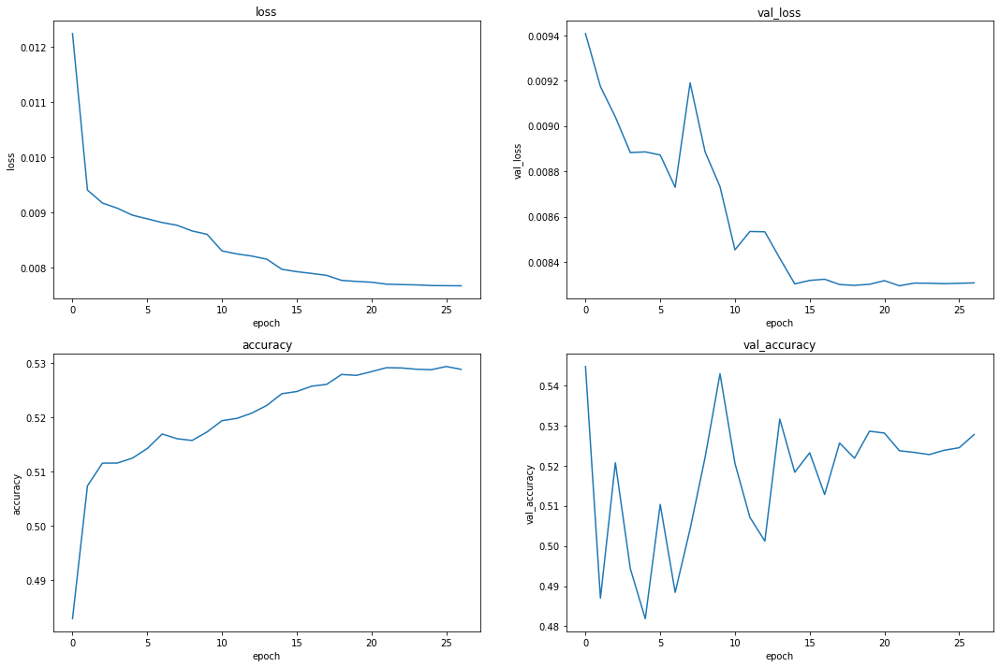

In [20]:
plot_metrics([result_default])

Wartości wszystkich 4 parametrów stabilizują się po około 20 epokach. Wtedy też wartości `accuracy` na zbiorze treningowym oraz testowym zaczynają być do siebie zbliżone, podobnie wygląda to też w przypadku straty.

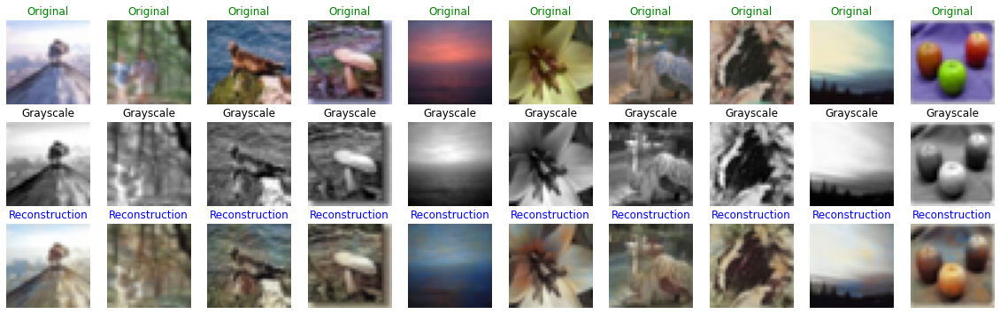

In [21]:
def plot_reconstructed_images(n = 10):
    plt.figure(figsize = (20, 6))
    for i in range(n):
        plt.subplot(3, n, i + 1)
        plt.title('Original', color = 'green')
        plt.axis('off')
        plt.imshow(y_test[i])

        plt.subplot(3, n, i + 1 + n)
        plt.title('Grayscale', color = 'black')
        plt.axis('off')
        plt.imshow(x_test[i], cmap = 'gray')
        
        plt.subplot(3, n, i + 1 + 2*n)
        plt.title('Reconstruction', color = 'blue')
        plt.axis('off')
        plt.imshow(autoencoder(x_test[i:i+1]).numpy().reshape((image_size, image_size, 3)))

plot_reconstructed_images()

Kolorując losowy zbiór zdjęć z `cifar100` można zauważyć, że sieć co prawda koloruje obrazki, ale odzwzorowanie barwy niekoniecznie zgadza się z tym, jak wyglądało to w oryginale - szczególnie "lubianym" odcieniem są tutaj brązy i beże. :)

## 2. Badanie wpływu metod regularyzacji na wynik

Tak, jak w przypadku sieci zaprezentowanej wcześniej, tutaj również zastosowane zostały callbacki: `EarlyStopping`, `ReduceLROnPlateau`, monitorujące `val_loss`, zatrzymujący trenowanie modelu lub redukujące `learning_rate` po odpowiednio pięciu lub trzech epokach bez poprawy tego parametru.

W dostępnej na `kaggle` wersji tensorflow (`2.4.1`) nie jest wspierany parametr `weight_decay` w optimizerze `Adam`, do zbadania wpływu tego parametru w jednym z eksperymentów zamieniono go na obiekt klasy `tfa.optimizers.AdamW`, będący implementacją tego samego algorytmu, ale z uwzględnieniem rozkładu wag.

Każde badanie zostało przeprowadzone dla 3 różnych wartości parametru. Jako funkcję straty użyto `MSE`. Każdy model trenowany był przez maksymalnie 25 epok.

In [51]:
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5),
    ReduceLROnPlateau(factor=0.1**0.5, patience=3, min_lr=0.5e-6)
]

def train_model(model, weight_decay=0, batch_size=64, epochs=20):
    if weight_decay:
        optimizer = tfa.optimizers.AdamW(weight_decay=weight_decay)
    else:
        optimizer = Adam()  
    model.compile(optimizer=optimizer, loss='mse', metrics=['accuracy'])
    model.build(input_shape=(None, None, None, 1))
    return model.fit(x_train, y_train, epochs=epochs, batch_size=batch_size, validation_data=(x_test, y_test), callbacks=callbacks)

In [30]:
photos_color_set = [
    io.imread('/kaggle/input/d/agnieszkaklimek/testphotos/building.jpg') / 255,
    io.imread('/kaggle/input/d/agnieszkaklimek/testphotos/dog.jpg') / 255,
    io.imread('/kaggle/input/d/agnieszkaklimek/testphotos/landscape.jpg') / 255,
]
photos_grayscale_set = [
    color.rgb2gray(photo) for photo in photos_color_set
]

In [31]:
def plot_test_photos(autoencoder):
    for image, image_gray in zip(photos_color_set, photos_grayscale_set):
        # Add a channels dimension
        image_gray = image_gray.reshape((1, image_gray.shape[0], image_gray.shape[1], 1))

        # Predict colorized image
        image_color = autoencoder(image_gray)

        # Plot the results
        plt.figure(figsize=(20, 10))
        plt.subplot(1, 3, 1)
        plt.imshow(image)
        plt.title('Original')
        plt.axis('off')
        plt.subplot(1, 3, 2)
        plt.imshow(image_gray.reshape((image_gray.shape[1], image_gray.shape[2])), cmap='gray')
        plt.title('Grayscale')
        plt.axis('off')
        plt.subplot(1, 3, 3)
        plt.imshow(image_color.numpy().reshape((image_color.shape[1], image_color.shape[2], 3)))
        plt.title('Colorized')
        plt.axis('off')
        plt.show()

### Badanie wpływu parametru momentum oraz rozmiaru batcha przy wykorzystaniu batch normalization

In [23]:
epochs_num_tests = 25

#### Badanie wpływu parametru `momentum` przy wykorzystaniu batch normalization

In [70]:
momentum_rate = (0.0, 0.5, 0.99)

with tpu_strategy.scope():
    autoencoder_m_0 = Autoencoder(batch_norm=True, momentum_rate=momentum_rate[0])
    autoencoder_m_1 = Autoencoder(batch_norm=True, momentum_rate=momentum_rate[1])
    autoencoder_m_2 = Autoencoder(batch_norm=True, momentum_rate=momentum_rate[2])

    result_m_0 = train_model(autoencoder_m_0, epochs=epochs_num_tests)
    result_m_1 = train_model(autoencoder_m_1, epochs=epochs_num_tests)
    result_m_2 = train_model(autoencoder_m_2, epochs=epochs_num_tests)

Epoch 1/25
782/782 [==============================] - 40s 41ms/step - loss: 0.0168 - accuracy: 0.4609 - val_loss: 0.0110 - val_accuracy: 0.5185
Epoch 2/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0096 - accuracy: 0.4971 - val_loss: 0.0104 - val_accuracy: 0.4815
Epoch 3/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0093 - accuracy: 0.5059 - val_loss: 0.0101 - val_accuracy: 0.5311
Epoch 4/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0091 - accuracy: 0.5112 - val_loss: 0.0092 - val_accuracy: 0.4877
Epoch 5/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0091 - accuracy: 0.5125 - val_loss: 0.0095 - val_accuracy: 0.5095
Epoch 6/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0090 - accuracy: 0.5175 - val_loss: 0.0092 - val_accuracy: 0.5002
Epoch 7/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0088 - accuracy: 0.5153 - val_loss: 0.0093 - val_accuracy:

In [71]:
autoencoder_m_0.save('./autoencoder_m_0', options=save_locally)
autoencoder_m_1.save('./autoencoder_m_1', options=save_locally)
autoencoder_m_2.save('./autoencoder_m_2', options=save_locally)

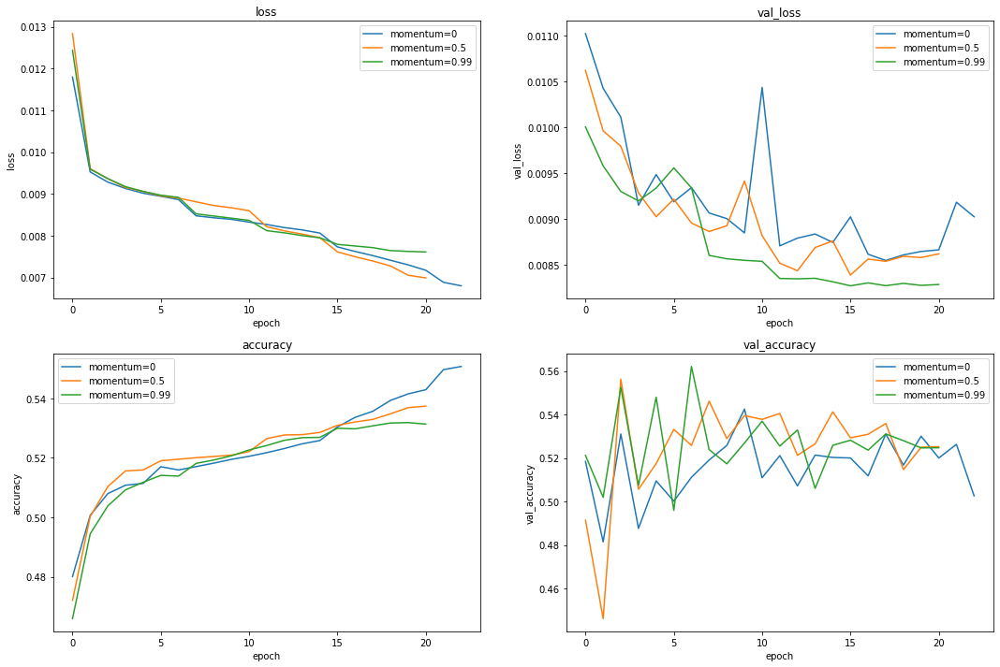

In [72]:
plot_metrics([result_m_0, result_m_1, result_m_2], legend=['momentum=0', 'momentum=0.5', 'momentum=0.99'])

Zastosowanie dodatkowych warstw `BatchNormalization` spowodowało większą róznorodność jeżeli chodzi o wartości funkcji straty oraz dokładności na zbiorze testowym. W przypadku sieci dla `momentum = 0`, można dodatkowo zaobserwować przy końcowych epokach gwałtowny wzrost `val_loss` oraz spadek `val_accuracy`, przy odwrotnej sytuacji na zbiorze treningowym, co może sygnalizować przeuczanie się modelu.

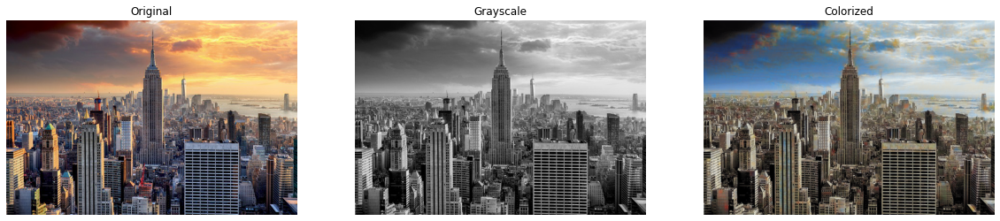

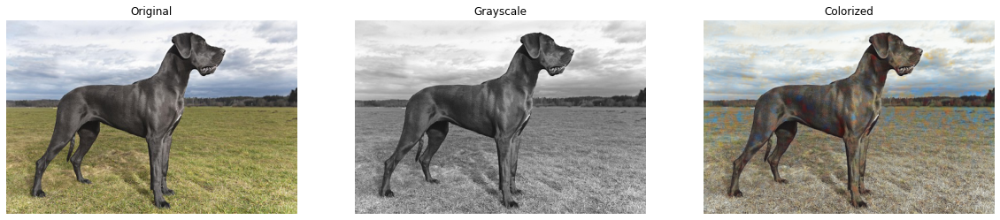

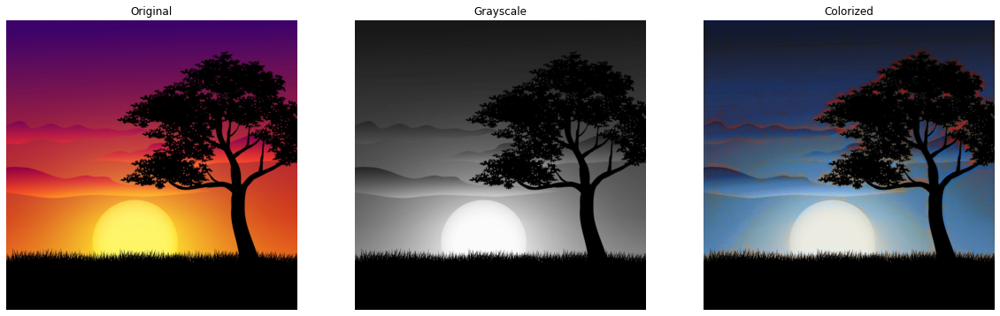

In [73]:
plot_test_photos(autoencoder_m_0)

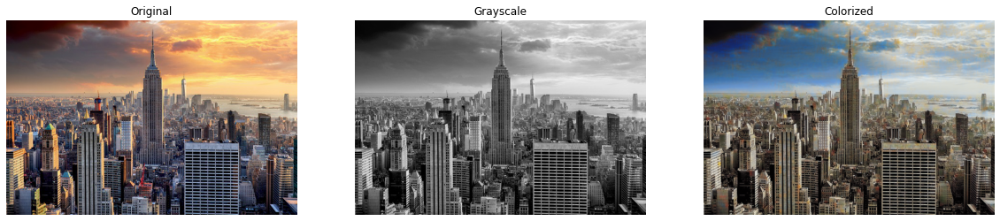

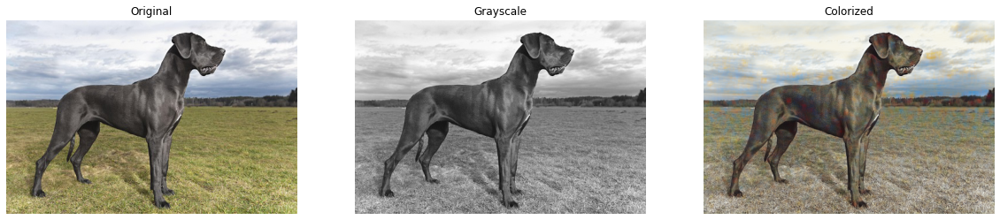

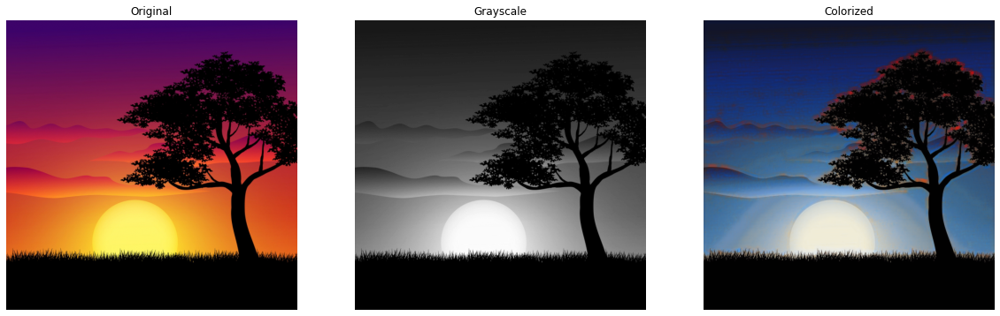

In [74]:
plot_test_photos(autoencoder_m_1)

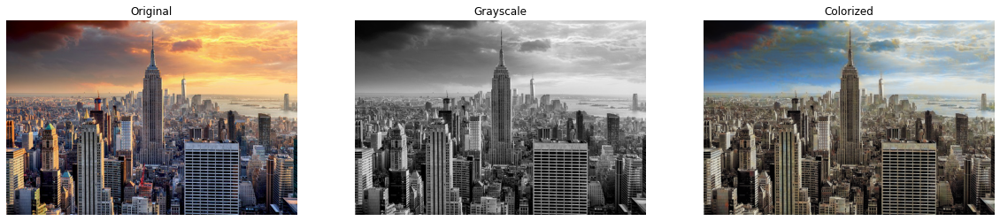

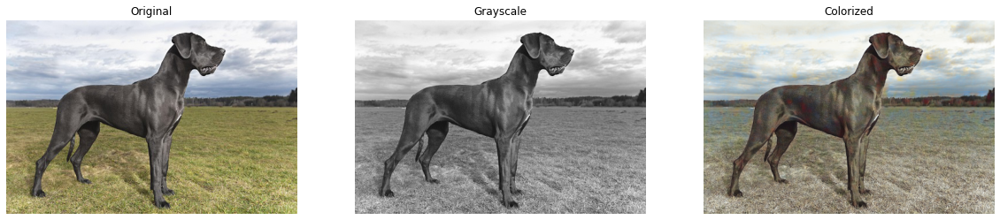

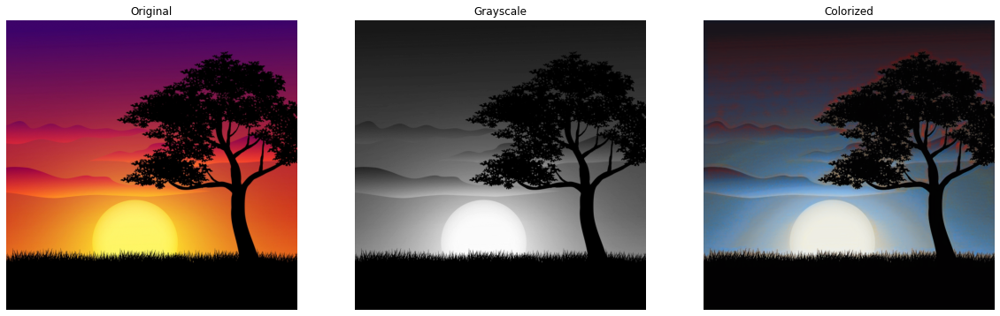

In [75]:
plot_test_photos(autoencoder_m_2)

Dla `momentum=0` przejścia kolorów na zdjęciach są najmniej gładkie, a na zdjęciu z psem zdecydowanie zauważalne są plamy, których widoczność jest zredukowana przy większych wartościach tego parametru. Przy wartości `momentum=0.99` przejścia te są najgładsze, a w odróżnieniu do pozostałych, mniej chętnie wybierany był kolor niebieski - co szczególnie widać na 3-cim obrazie.

#### Badanie wpływu `batch_size` przy wykorzystaniu batch normalization

In [37]:
batch_size = (32, 64, 128)

with tpu_strategy.scope():
    autoencoder_batch_0 = Autoencoder(batch_norm=True, momentum_rate=0.99)
    autoencoder_batch_1 = Autoencoder(batch_norm=True, momentum_rate=0.99)
    autoencoder_batch_2 = Autoencoder(batch_norm=True, momentum_rate=0.99)

    result_batch_0 = train_model(autoencoder_batch_0, batch_size=batch_size[0], epochs=epochs_num_tests)
    result_batch_1 = train_model(autoencoder_batch_1, batch_size=batch_size[1], epochs=epochs_num_tests)
    result_batch_2 = train_model(autoencoder_batch_2, batch_size=batch_size[2], epochs=epochs_num_tests)

Epoch 1/25
1563/1563 [==============================] - 55s 29ms/step - loss: 0.0149 - accuracy: 0.4632 - val_loss: 0.0097 - val_accuracy: 0.5091
Epoch 2/25
1563/1563 [==============================] - 31s 20ms/step - loss: 0.0097 - accuracy: 0.5068 - val_loss: 0.0095 - val_accuracy: 0.5043
Epoch 3/25
1563/1563 [==============================] - 31s 20ms/step - loss: 0.0094 - accuracy: 0.5125 - val_loss: 0.0092 - val_accuracy: 0.5005
Epoch 4/25
1563/1563 [==============================] - 32s 21ms/step - loss: 0.0091 - accuracy: 0.5203 - val_loss: 0.0095 - val_accuracy: 0.4325
Epoch 5/25
1563/1563 [==============================] - 32s 20ms/step - loss: 0.0091 - accuracy: 0.5185 - val_loss: 0.0090 - val_accuracy: 0.5207
Epoch 6/25
1563/1563 [==============================] - 31s 20ms/step - loss: 0.0089 - accuracy: 0.5254 - val_loss: 0.0091 - val_accuracy: 0.5265
Epoch 7/25
1563/1563 [==============================] - 31s 20ms/step - loss: 0.0088 - accuracy: 0.5211 - val_loss: 0.0091 -

In [39]:
autoencoder_batch_0.save('./autoencoder_batch_0', options=save_locally)
autoencoder_batch_1.save('./autoencoder_batch_1', options=save_locally)
autoencoder_batch_2.save('./autoencoder_batch_2', options=save_locally)

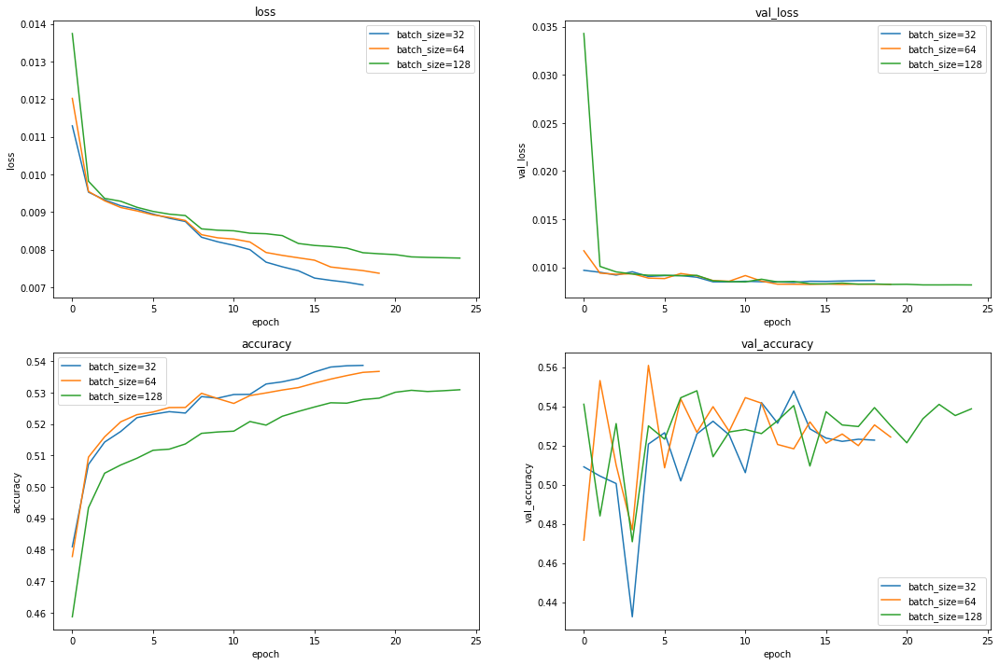

In [40]:
plot_metrics([result_batch_0, result_batch_1, result_batch_2], legend=['batch_size=32', 'batch_size=64', 'batch_size=128'])

Przy zastosowaniu różnych rozmiarów `batch_size`, modele osiagały końcowo podobne wartości jeżeli chodzi o stratę oraz dokładność. Początkowo jednak, im wiekszy rozmiar był nadany, tym większa była wartość funkcji straty oraz mniejsza dokładność - zarówno na zbiorze testowym, jaki i treningowym. Im mniejszy `batch_size`, tym wcześniej kończył się trening modelu. Trenowanie odbywało się za pomocą TPU, sporą różnicę między rozmiarami dało się odczuć w czasie trwaia jednej epoki - od 10 sekund dla `batch_size=128`, aż do 30 sekund przy `batch_size=32`.

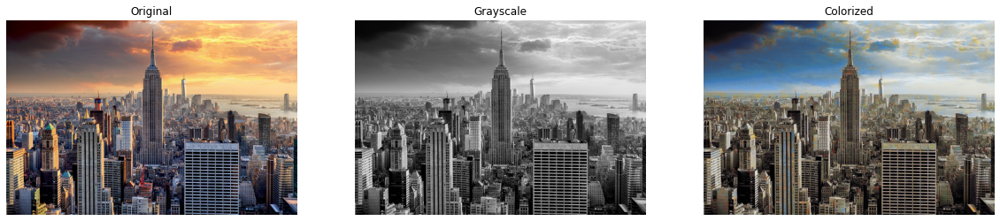

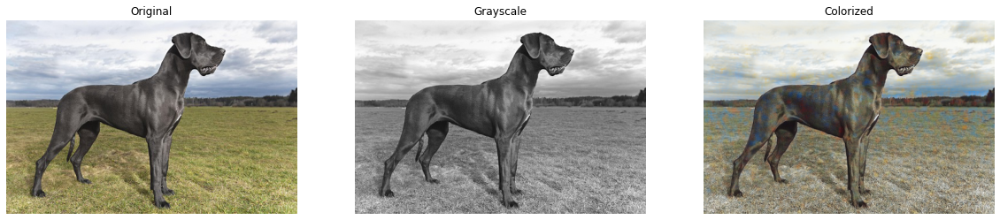

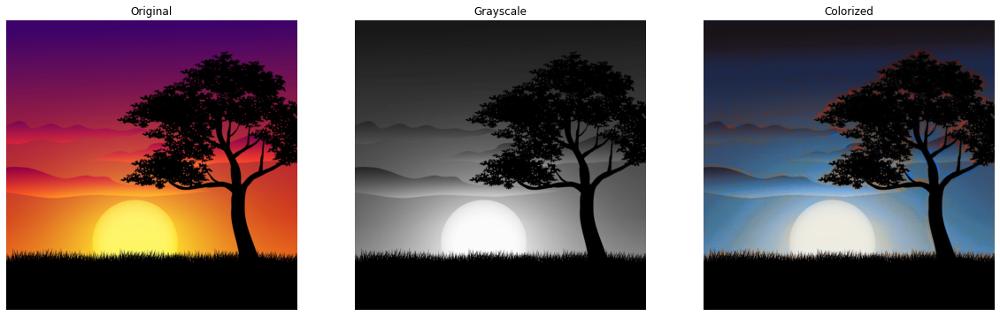

In [41]:
plot_test_photos(autoencoder_batch_0)

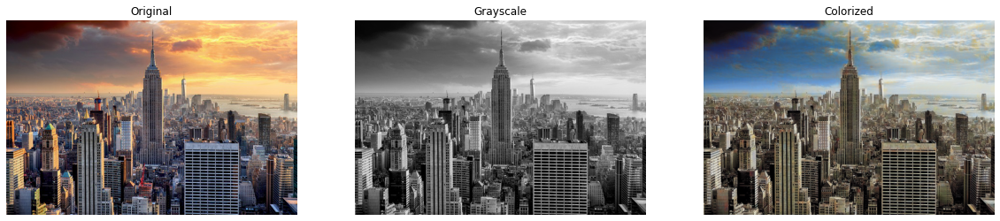

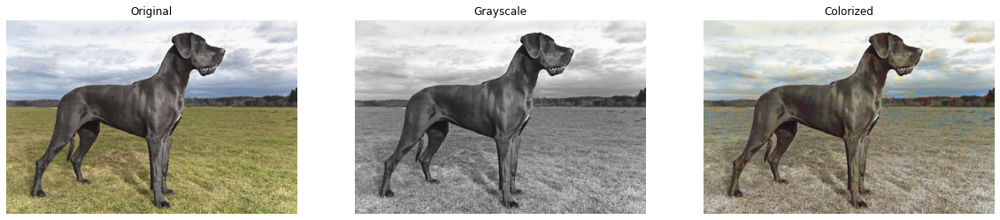

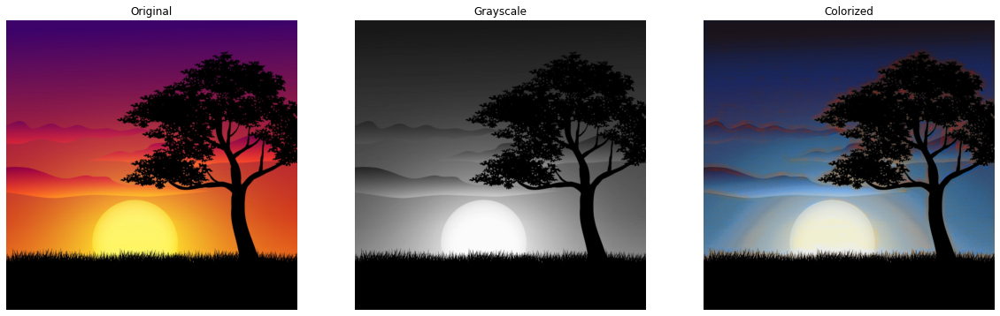

In [42]:
plot_test_photos(autoencoder_batch_1)

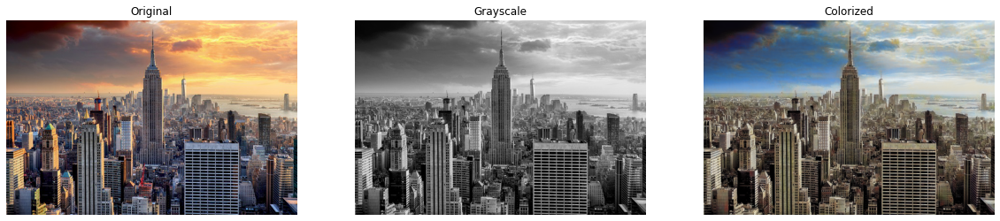

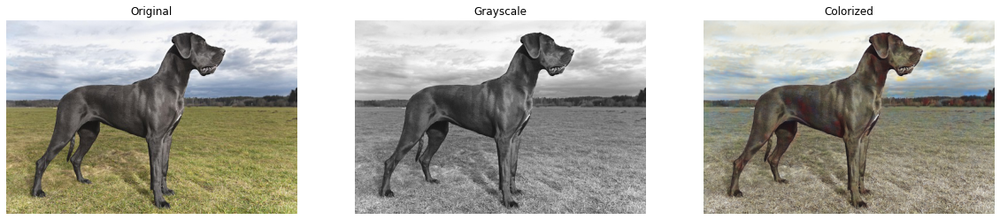

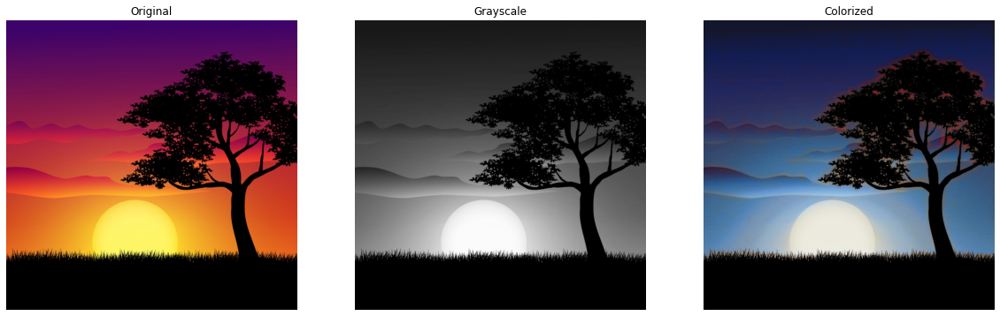

In [43]:
plot_test_photos(autoencoder_batch_2)

Wizualnie, ciężko ocenić wpływ `batch_size` na efekt końcowy - zdjęcia pokolorowane przez każdy autoenkoder są do siebie zbliżone wyglądem.

### Badanie wpływu dropout rate

In [44]:
dropout_rate = (0, 0.1, 0.3)

with tpu_strategy.scope():
    autoencoder_dropout_0 = Autoencoder(dropout_rate=dropout_rate[0])
    autoencoder_dropout_1 = Autoencoder(dropout_rate=dropout_rate[1])
    autoencoder_dropout_2 = Autoencoder(dropout_rate=dropout_rate[2])

    result_dropout_0 = train_model(autoencoder_dropout_0, epochs=epochs_num_tests)
    result_dropout_1 = train_model(autoencoder_dropout_1, epochs=epochs_num_tests)
    result_dropout_2 = train_model(autoencoder_dropout_2, epochs=epochs_num_tests)

Epoch 1/25
782/782 [==============================] - 37s 40ms/step - loss: 0.0190 - accuracy: 0.4764 - val_loss: 0.0096 - val_accuracy: 0.5001
Epoch 2/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0095 - accuracy: 0.4958 - val_loss: 0.0091 - val_accuracy: 0.5171
Epoch 3/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0093 - accuracy: 0.5125 - val_loss: 0.0091 - val_accuracy: 0.5198
Epoch 4/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0091 - accuracy: 0.5143 - val_loss: 0.0099 - val_accuracy: 0.5129
Epoch 5/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0090 - accuracy: 0.5168 - val_loss: 0.0089 - val_accuracy: 0.5379
Epoch 6/25
782/782 [==============================] - 17s 21ms/step - loss: 0.0089 - accuracy: 0.5148 - val_loss: 0.0090 - val_accuracy: 0.5480
Epoch 7/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0089 - accuracy: 0.5145 - val_loss: 0.0089 - val_accuracy:

In [45]:
autoencoder_dropout_0.save('./autoencoder_dropout_0', options=save_locally)
autoencoder_dropout_1.save('./autoencoder_dropout_1', options=save_locally)
autoencoder_dropout_2.save('./autoencoder_dropout_2', options=save_locally)

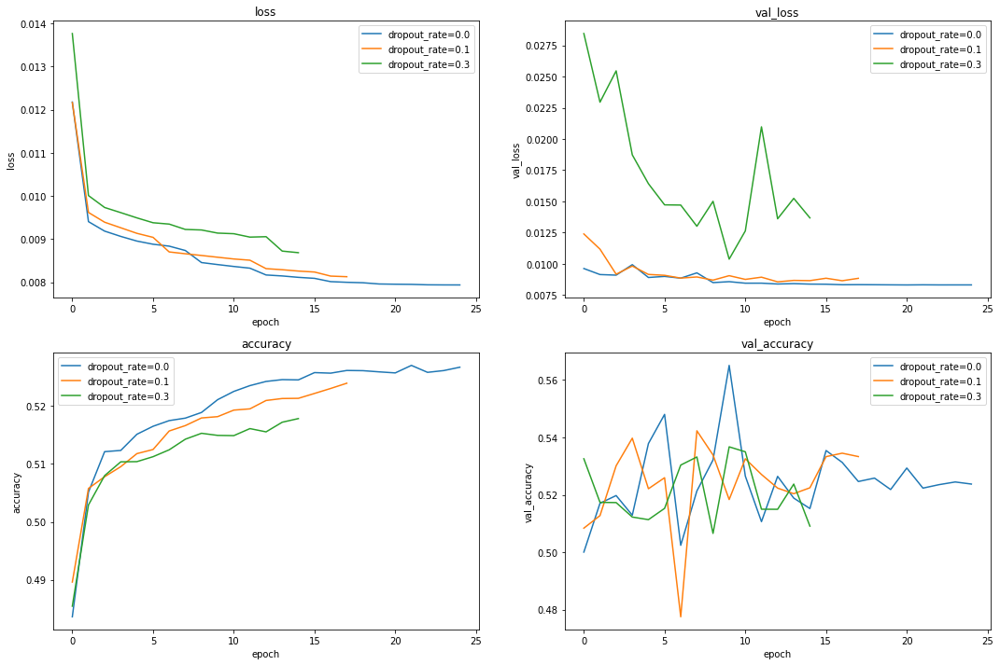

In [46]:
plot_metrics(
    [result_dropout_0, result_dropout_1, result_dropout_2],
    legend=['dropout_rate=0.0', 'dropout_rate=0.1', 'dropout_rate=0.3']
)

Dla większej wartości `dropout` można zaobserwować znacznie większą wartość funkcji straty niż ma to miejsce w przypadku mniejszych wartości. Model ten najwcześniej przestawał być trenowany. Jak można zauważyć, parametr ten, gdy jest zbyt duży, może skutecznie dezorientować model i utrudniać mu naukę.

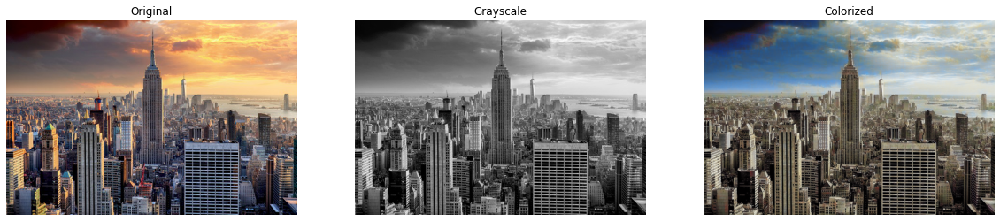

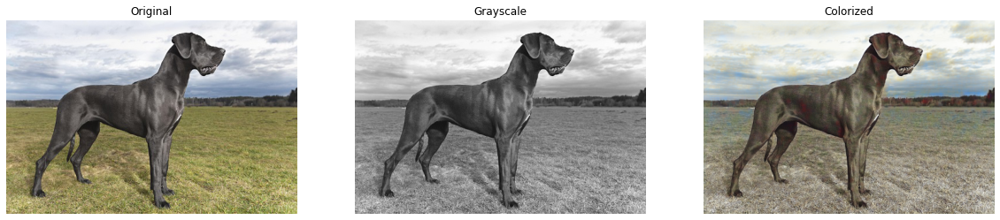

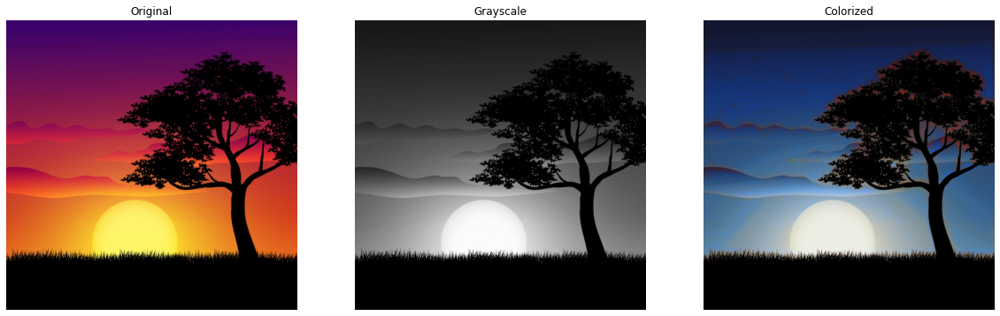

In [47]:
plot_test_photos(autoencoder_dropout_0)

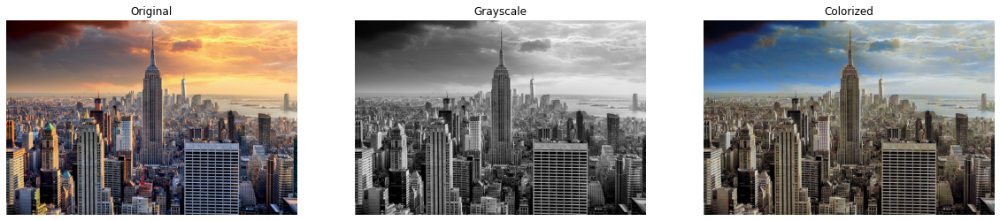

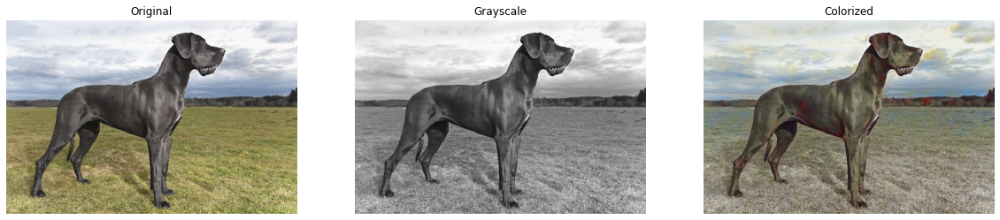

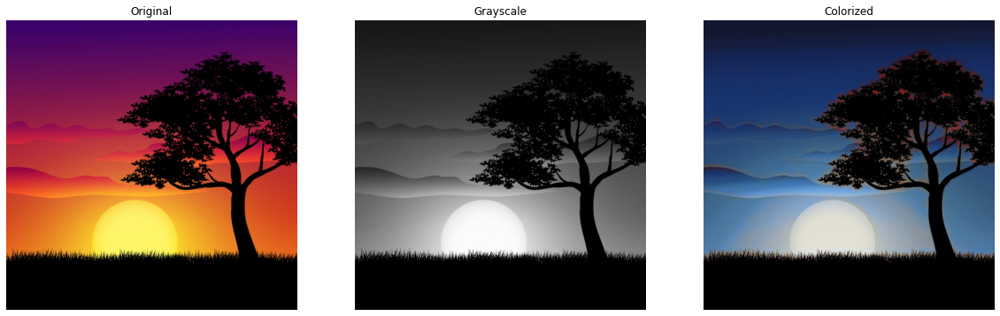

In [48]:
plot_test_photos(autoencoder_dropout_1)

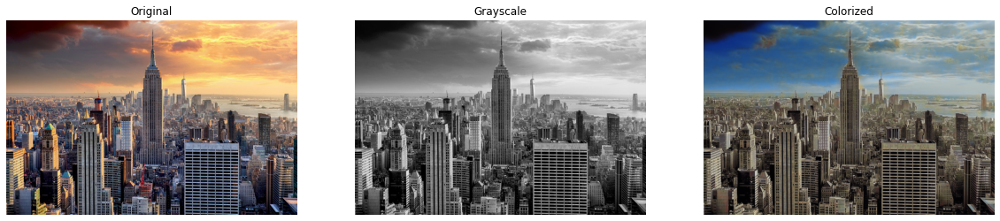

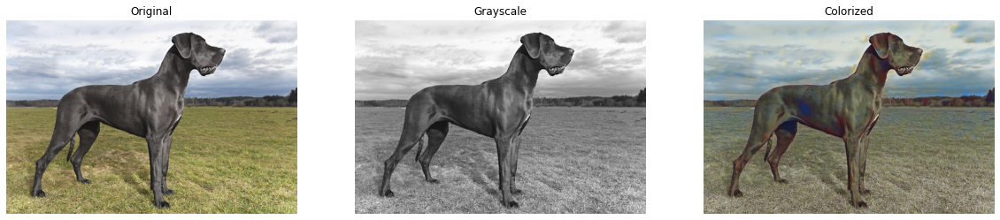

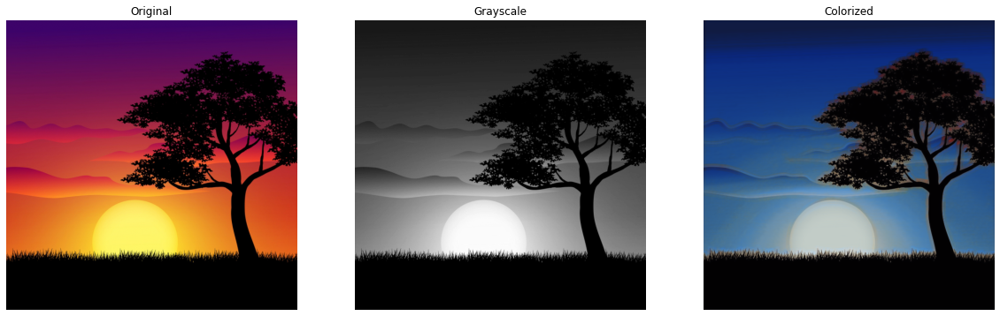

In [49]:
plot_test_photos(autoencoder_dropout_2)

Dla wartości `dropout=0` oraz `dropout=0.1` zdjęcia są zbliżone do siebie, natomiast dla `dropout=0.3` zaobserwować można różnice - kolory są bardziej płaskie i mniej różnorodne, z gorszą jakością granic pomiędzy obiektami - np. chmury na obrazku 3cim są słabo zaznaczone w porównaniu do porzedników, a na 1 obrazie, w lewym gównym rogu, gdzie powinna znajdować się ciemny zarys chmury, widnieje coś, co bardziej przypomina ciemny trójkąt.

### Badanie wpływu weight decay

In [99]:
weight_decay = (0.01, 0.001, 0.0001)

with tpu_strategy.scope():
    autoencoder_weight_0 = Autoencoder()
    autoencoder_weight_1 = Autoencoder()
    autoencoder_weight_2 = Autoencoder()

    result_weight_0 = train_model(autoencoder_weight_0, epochs=epochs_num_tests, weight_decay=weight_decay[0])
    result_weight_1 = train_model(autoencoder_weight_1, epochs=epochs_num_tests, weight_decay=weight_decay[1])
    result_weight_2 = train_model(autoencoder_weight_2, epochs=epochs_num_tests, weight_decay=weight_decay[2])

Epoch 1/25
782/782 [==============================] - 42s 41ms/step - loss: 0.0234 - accuracy: 0.5061 - val_loss: 0.0247 - val_accuracy: 0.5522
Epoch 2/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0190 - accuracy: 0.5437 - val_loss: 0.0312 - val_accuracy: 0.5566
Epoch 3/25
782/782 [==============================] - 17s 21ms/step - loss: 0.0245 - accuracy: 0.5486 - val_loss: 0.0265 - val_accuracy: 0.5566
Epoch 4/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0234 - accuracy: 0.5481 - val_loss: 0.0256 - val_accuracy: 0.5506
Epoch 5/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0239 - accuracy: 0.5421 - val_loss: 0.0253 - val_accuracy: 0.5010
Epoch 6/25
782/782 [==============================] - 17s 22ms/step - loss: 0.0257 - accuracy: 0.5319 - val_loss: 0.0260 - val_accuracy: 0.5539
Epoch 1/25
782/782 [==============================] - 39s 40ms/step - loss: 0.0198 - accuracy: 0.4843 - val_loss: 0.0099 - val_accuracy:

In [59]:
autoencoder_weight_0.save('./autoencoder_weight_0', options=save_locally)
autoencoder_weight_1.save('./autoencoder_weight_1', options=save_locally)
autoencoder_weight_2.save('./autoencoder_weight_2', options=save_locally)

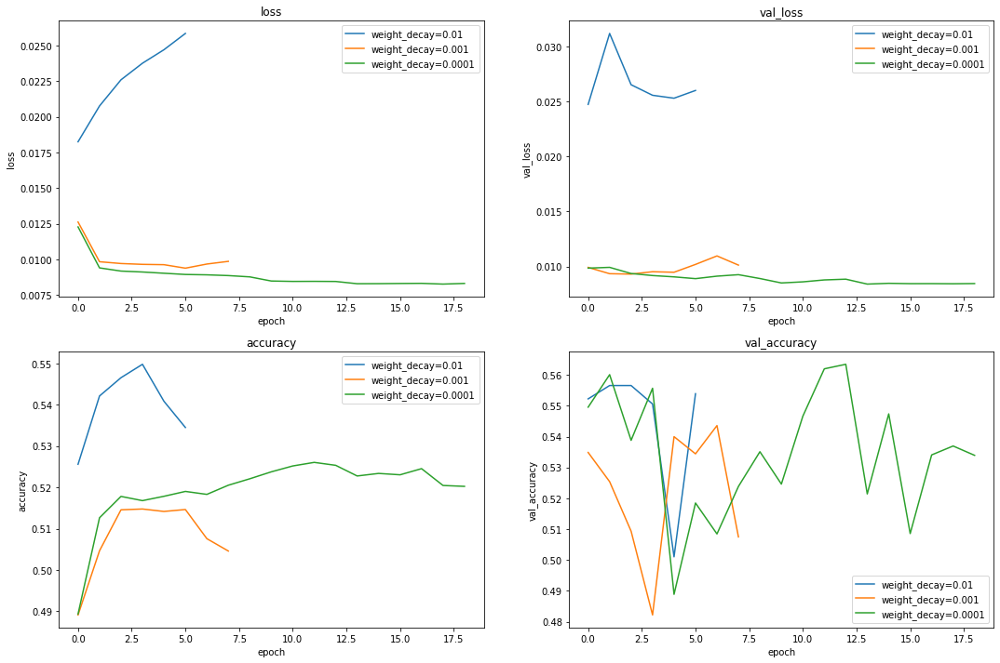

In [104]:
plot_metrics(
    [result_weight_0, result_weight_1, result_weight_2],
    legend=['weight_decay=0.01', 'weight_decay=0.001', 'weight_decay=0.0001']
)

Dla parametru `weight_decay`, zdecydowanie lepiej radził sobie model z najmniejszą jej wartością, dla której to wartość funkcji straty sukcesywnie malała. Najgorzej zaprezentował się model z `weight_decay=0.01`, który co prawda osiągnął najlepsze wyniki jeżeli chodzi o `accuracy`, ale również najgorsze dla parametru `loss`.

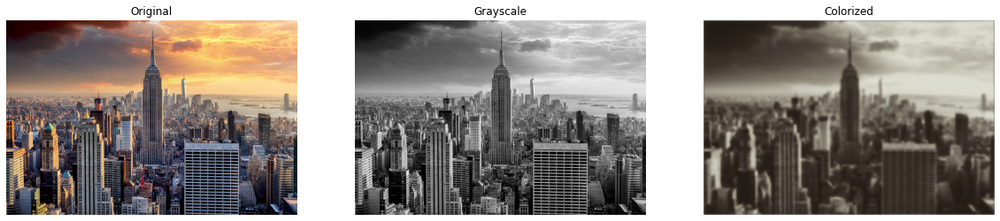

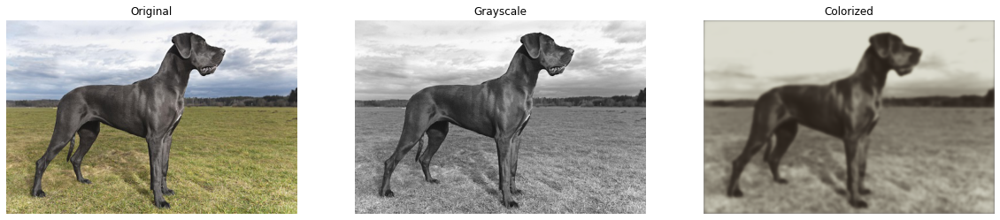

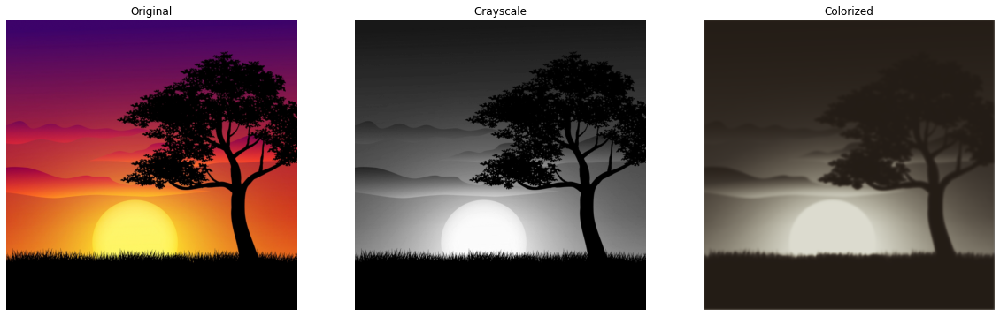

In [101]:
plot_test_photos(autoencoder_weight_0)

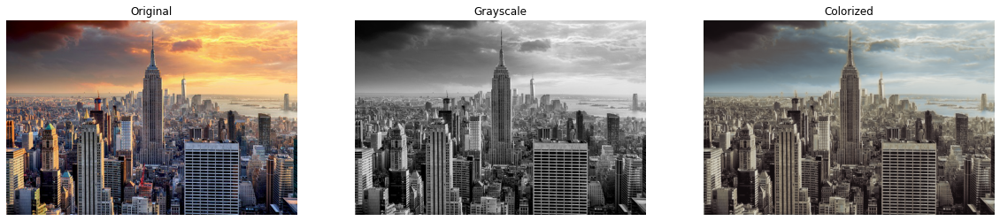

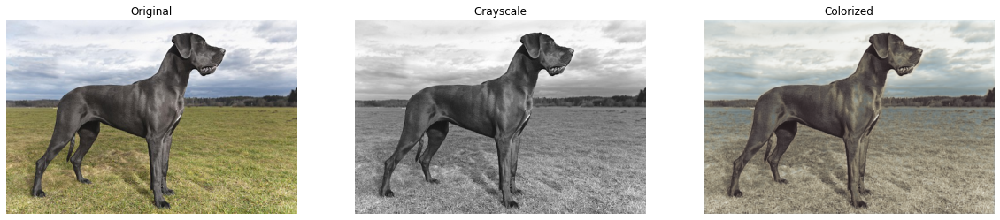

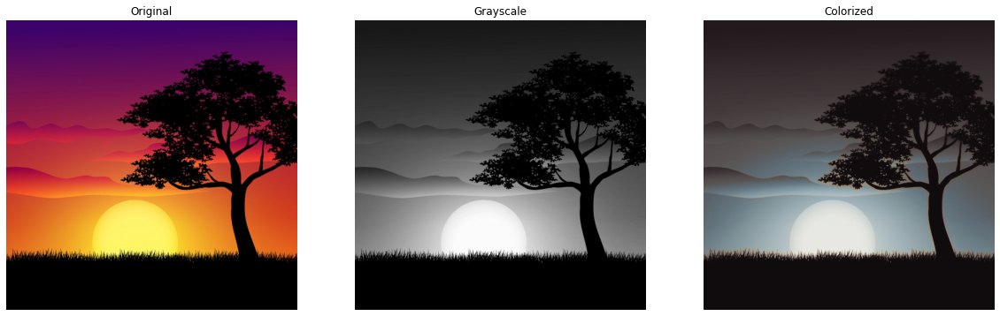

In [102]:
plot_test_photos(autoencoder_weight_1)

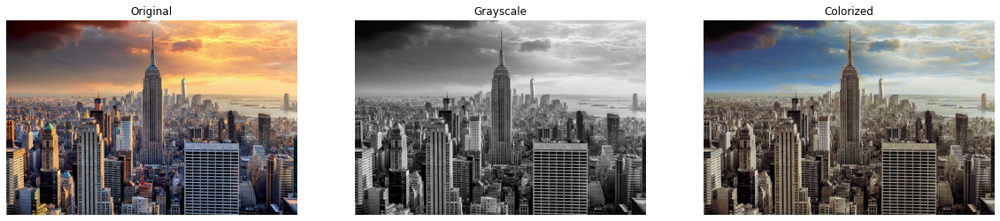

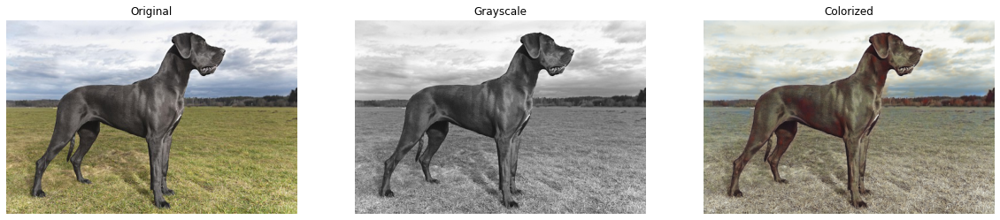

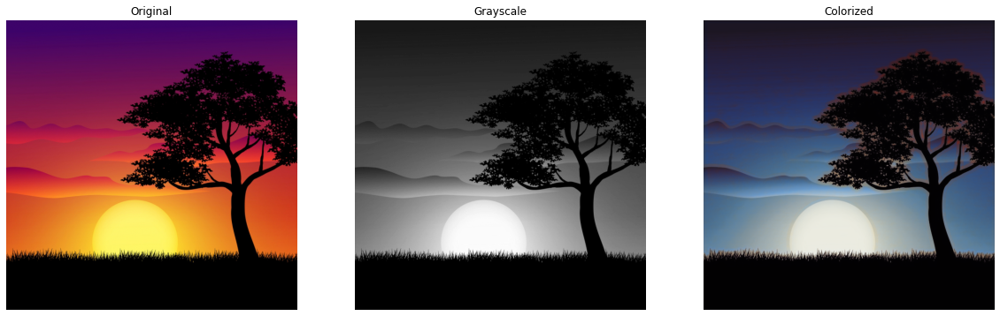

In [103]:
plot_test_photos(autoencoder_weight_2)

Im większa jest wartość `weight_decay`, tym mniej kolorów znalazło się na zajęciu. Całość jest też mocno rozmyta dla modelu z największym parametrem - model ten jednak zakończył trenowanie najwcześniej. Tak, jak w przypadku `dropout`, można zauważyć, że dobranie zbyt dużej wartości powoduje skutek odwrotny do zamierzonego, i coś, co miało służyć regularyzacji i zapobiegać przeuczaniu, w rzeczywistości utrudnia osiągnięcie zamierzonego skutku.

## 3. Kolorowanie zdjęć o różnym rozmiarze wejściowym

Poniżej zaprezentowane zostały przykłady zdjęć dla podstawowej sieci, prezentowanej w punkcie pierwszym, tym razem o różnych wymiarach.

In [76]:
def plot_reconstructed_image(path):
    image = io.imread(path)
    image = image / 255.
    gray_image =  color.rgb2gray(image)
    gray_image = gray_image.reshape((1, gray_image.shape[0], gray_image.shape[1], 1))
    color_image = autoencoder(gray_image)
    
    plt.figure(figsize=(20, 10))
    plt.subplot(1, 3, 1)
    plt.title('Original', color = 'green')
    plt.axis('off')
    plt.imshow(image)
    
    plt.subplot(1, 3, 2)
    plt.title('Grayscale', color = 'black')
    plt.axis('off')
    plt.imshow(gray_image.reshape((gray_image.shape[1], gray_image.shape[2])), cmap='gray')
    
    plt.subplot(1, 3, 3)
    plt.title('Reconstruction', color = 'blue')
    plt.axis('off')
    plt.imshow(color_image.numpy().reshape((color_image.shape[1], color_image.shape[2], 3)))

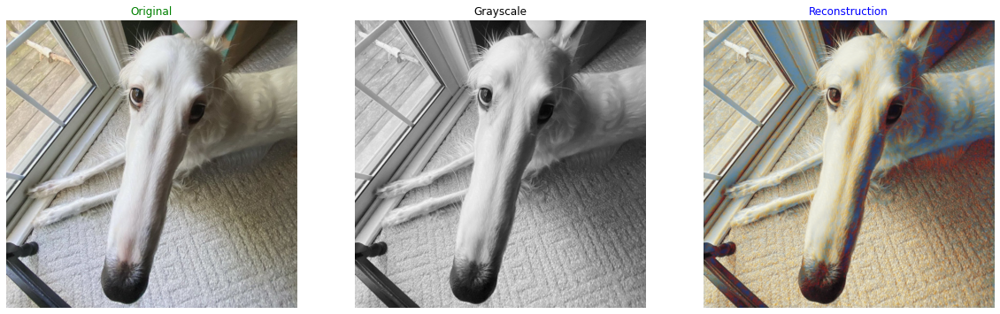

In [77]:
plot_reconstructed_image('/kaggle/input/testing/doggo.jpg')

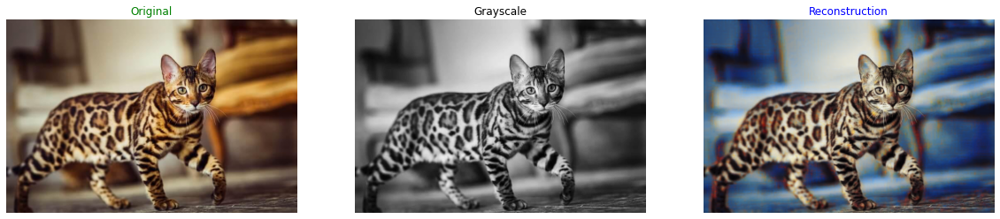

In [78]:
plot_reconstructed_image('/kaggle/input/testing/bengal-cat.jpg')

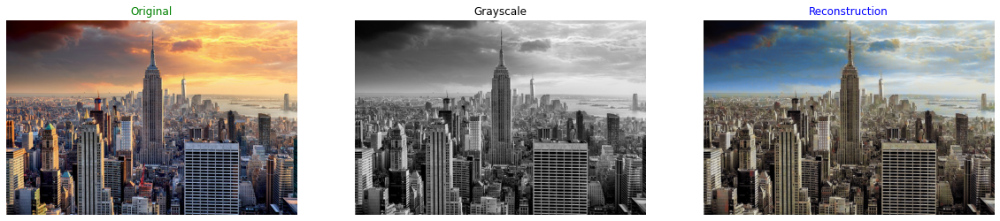

In [79]:
plot_reconstructed_image('/kaggle/input/d/agnieszkaklimek/testphotos/building.jpg')

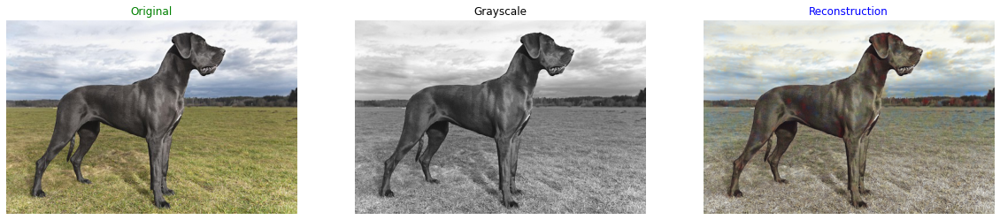

In [80]:
plot_reconstructed_image('/kaggle/input/d/agnieszkaklimek/testphotos/dog.jpg')

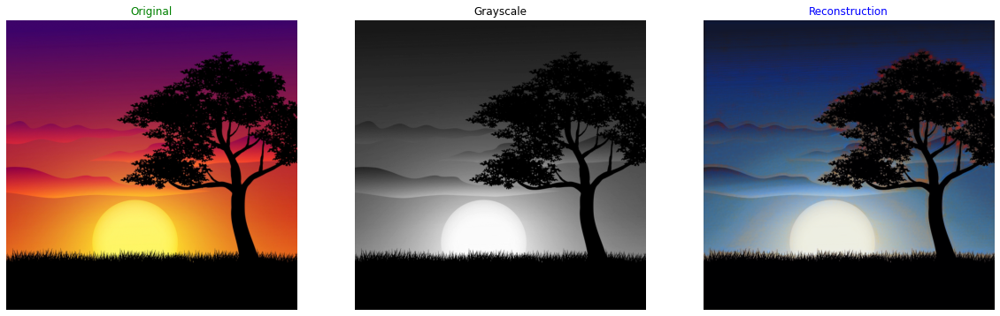

In [81]:
plot_reconstructed_image('/kaggle/input/d/agnieszkaklimek/testphotos/landscape.jpg')

### 4. Podsumowanie

Eksperymenty pozwoliły nam na lepsze zrozumienie sieci neuronowych oraz wpływu różnych parametrów na jej działanie. Dalszą drogą rozwoju mogłaby być rozbudowa sieci, która spowodowałoby w efekcie szansę na dokładniejsze odwzorowanie rzeczywistych kolorów.